## Shell Contact Example

In [1]:
# !pip install debugpy

In [2]:
import numpy as np

import dismech


geom = dismech.GeomParams(rod_r0=0.005,
                          shell_h=0.005)

material = dismech.Material(density=1200,
                            youngs_rod=0,
                            youngs_shell=2e10,
                            poisson_rod=0,
                            poisson_shell=0.5)

shell_contact_sim = dismech.SimParams(static_sim=False,
                                  two_d_sim=False,   # no twisting
                                  use_mid_edge=False,
                                  use_line_search=False,
                                  show_floor=False,
                                  log_data=True,
                                  log_step=1,
                                  dt=1e-2,
                                  max_iter=100,
                                  total_time=5,
                                  plot_step=1,
                                  tol=1e-4,
                                  ftol=1e-4,
                                  dtol=1e-2)

env = dismech.Environment()
env.add_force('gravity', g=np.array([0.0, 0.0, 0]))
# env.add_force('viscous', eta = 10)
# env.add_force('aerodynamics', rho=1000, cd=1)
env.add_force('hydrodynamics', rho=1000, cd=10)
env.add_force('thrust', thrust_coeff = 10000)

# env.add_force('selfContact', delta=0.01*2*5e-3, h=5e-3)
# env.set_static()  

geo = dismech.Geometry.from_txt('input hemisphere more dense.txt')

robot = dismech.SoftRobot(geom, material, geo, shell_contact_sim, env)

# u = robot.state.u
# u[11] = -0.5
# u[14] = -0.5
# u[17] = -0.5

In [3]:
log_node = np.array(np.where(
    robot.state.q[robot.node_dof_indices].reshape(-1, 3)[:, 2] >= 0.99)[0])

In [4]:
print("# nodes: ", np.shape(robot.nodes))
print("# faces: ", np.shape(robot.face_nodes_shell))

# nodes:  (105, 3)
# faces:  (176, 3)


In [5]:
# print("bending stiffness kb: ", robot.hinge_springs.kb)

### Time Stepping

As we are performing a static simulation, we must change gravity for each time step.

In [6]:
stepper = dismech.ImplicitEulerTimeStepper(robot)



In [7]:
# from scipy.signal import sawtooth
# def actuate_jellyfish(robot, t):
#     """
#     Apply jellyfish-like pulsatile actuation by modifying theta_bar on hinge_springs.

#     Parameters
#     ----------
#     robot : object
#         Robot structure with hinge_springs list and per-hinge theta_bar field.
#     t : float
#         Current simulation time.
#     hinge_to_nodes : (N_hinges, 2) array of int
#         For each hinge, indices of its two nodes.
#     mesh_nodes : (N_nodes, 3) array of float
#         3D positions of each mesh node.
#     """
#     # --- Parameters ---
#     pulse_freq = 2.0                 # Hz, contraction frequency
#     pulse_amplitude = 2*np.pi     # Max natural angle change (rad)
#     contraction_time = 0.2          # Fraction of cycle for contraction
#     theta_rest = 0.0                # Resting (fully open) angle

#     # Temporal asymmetric pulse profile
#     T = 1.0 / pulse_freq

#     """ fast contraction passive relaxation: """
#     # tau = t % T
#     # if tau < contraction_time * T:
#     #     s = np.sin(np.pi * tau / (contraction_time * T))  # fast contraction
#     # else:
#     #     s = 0.0  # slow passive expansion

#     """ Full sine cycle over the period T: """
#     # s = 0.5 * (1 - np.cos(2 * np.pi * t / T))  # Range: [0, 1]

#     """ Sawtooth (active assymetric contraction and relaxation): """
#     s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))  # width < 0.5 = faster rise
#     theta_base = theta_rest - pulse_amplitude * s

#     # Compute radial distance of hinge midpoint from apex
#     n_hinges = robot.hinge_springs.inc_strain.shape[0]
#     theta_bars = np.zeros(n_hinges)

#     # Assume apex is at the top (e.g., max z)
#     apex = np.max(robot.face_nodes_shell[:, 2])
#     base_radius = np.max(np.linalg.norm(robot.face_nodes_shell[:, :2], axis=1))

#     for i in range(n_hinges):
#         n1, n2 = robot.hinge_springs.nodes_ind[i, 0:2]
#         midpoint = 0.5 * (robot.face_nodes_shell[n1] + robot.face_nodes_shell[n2])
#         radial_dist = np.linalg.norm(midpoint[:2])  # XY plane

#         # Linearly scale actuation from apex to base
#         scale = radial_dist / base_radius
#         theta_bars[i] = theta_base * scale

#     # Apply actuation to hinge_springs
#     robot.hinge_springs.inc_strain = theta_bars

#     return robot
# # print(robot.hinge_springs.inc_strain)
# stepper.before_step = actuate_jellyfish

In [8]:
from scipy.signal import sawtooth

def actuate_jellyfish(robot, t):
    pulse_freq = 2.0
    pulse_amplitude = 2 * np.pi
    theta_rest = 0.0

    T = 1.0 / pulse_freq
    s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))
    theta_base = theta_rest - pulse_amplitude * s

    n_hinges = robot.hinge_springs.inc_strain.shape[0]
    theta_bars = np.zeros(n_hinges)

    apex = np.max(robot.face_nodes_shell[:, 2])
    base_radius = np.max(np.linalg.norm(robot.face_nodes_shell[:, :2], axis=1))

    for i in range(n_hinges):
        n1, n2 = robot.hinge_springs.nodes_ind[i, 0:2]
        midpoint = 0.5 * (robot.face_nodes_shell[n1] + robot.face_nodes_shell[n2])
        r = np.linalg.norm(midpoint[:2]) / base_radius  # normalized radius

        # Quadratic scaling: activates more of the bell
        scale = 3 * r**2 - 2 * r**3 # Try also: scale = 3*r**2 - 2*r**3 for smoothstep

        theta_bars[i] = theta_base * scale

    robot.hinge_springs.inc_strain = theta_bars
    return robot

stepper.before_step = actuate_jellyfish

In [9]:
print(robot.hinge_springs.inc_strain.shape)

(248,)


In [10]:
# from scipy.signal import sawtooth

# def actuate_jellyfish(robot, t):
#     """
#     Apply jellyfish-like actuation by modifying inc_strain safely.
#     Ensures theta_bar = nat + inc is always in [0, π].
#     """
#     # Parameters
#     pulse_freq = 2.0               # Hz
#     pulse_amplitude = 1.0          # Max actuation (rad), don't go beyond π
#     theta_rest = 0.0               # Reference shift (not needed in your def)

#     # Temporal profile: asymmetric sawtooth contraction + expansion
#     T = 1.0 / pulse_freq
#     s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))  # s ∈ [0,1]
#     inc_base = -pulse_amplitude * s  # contraction

#     # Geometry-based spatial scaling
#     n_hinges = robot.hinge_springs.inc_strain.shape[0]
#     inc_strain = np.zeros(n_hinges)

#     face_nodes = robot.face_nodes_shell
#     node_z = face_nodes[:, 2]
#     max_z = np.max(node_z)
#     min_z = np.min(node_z)

#     for i in range(n_hinges):
#         n1, n2 = robot.hinge_springs.nodes_ind[i, :2]
#         z1 = face_nodes[n1, 2]
#         z2 = face_nodes[n2, 2]
#         z_avg = 0.5 * (z1 + z2)

#         arc_fraction = (max_z - z_avg) / (max_z - min_z)  # apex=0, base=1

#         # Smooth spatial profile (can try linear, cosine, etc.)
#         scale = 0.5 * (1 - np.cos(np.pi * arc_fraction))  # ∈ [0,1]
#         scaled_inc = inc_base * scale

#         # Safety: clip total theta_bar = nat + inc to [0, π]
#         nat = robot.hinge_springs.nat_strain[i]
#         max_allowed = np.pi - nat
#         min_allowed = -nat
#         # inc_strain[i] = np.clip(scaled_inc, min_allowed, max_allowed)
#         inc_strain[i] = scaled_inc

#     robot.hinge_springs.inc_strain = inc_strain
#     return robot

# stepper.before_step = actuate_jellyfish

In [11]:
robots = stepper.simulate()

qs = np.stack([robot.state.q for robot in robots])

54157.08786920298
6794011.333279615
dV/dt: -4.12097, Total thrust: [    0.             0.         41209.73441503]
2041052.3662155322
dV/dt: -3.50987, Total thrust: [    0.             0.         35098.71667548]
59497.66355059159
dV/dt: -2.65416, Total thrust: [    0.          0.      26541.58765]
448825.2629215935
dV/dt: -2.70268, Total thrust: [    0.             0.         27026.75259067]
9406.11531849025
dV/dt: -2.62248, Total thrust: [    0.             0.         26224.83296411]
149434.57999454305
dV/dt: -2.64484, Total thrust: [    0.             0.         26448.41411244]
709.5684633307766
dV/dt: -2.64894, Total thrust: [    0.             0.         26489.39733414]
3995.319677765957
current_time:  0.01
12404.398670777226
dV/dt: -3.00895, Total thrust: [    0.             0.         30089.46625972]
1638862.9686690175
dV/dt: -3.16173, Total thrust: [    0.             0.         31617.33482707]
21686.237049992204
dV/dt: -2.89898, Total thrust: [    0.             0.         28989

[[7.01323993e-04 4.15692732e-04 1.00260626e+00]
 [6.49370839e-04 7.81290606e-04 1.00943305e+00]
 [5.99549864e-04 1.17845255e-03 1.01526066e+00]
 ...
 [1.22766574e-02 1.62478036e-02 1.55881286e+00]
 [1.21763337e-02 1.68803361e-02 1.56143257e+00]
 [1.20705917e-02 1.75369479e-02 1.56406393e+00]]


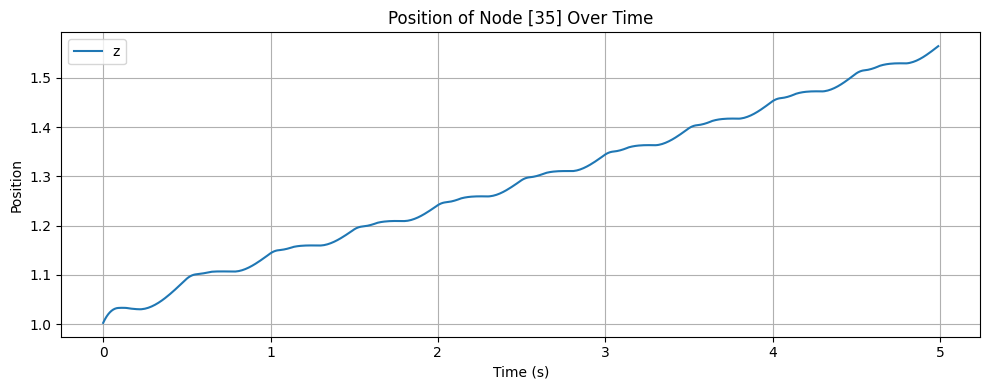

In [12]:
import matplotlib.pyplot as plt

# Extract the DOF indices (x, y, z) of the node you want to track
log_node_dofs = robot.map_node_to_dof(log_node)  # e.g., [ix, iy, iz]

# Extract position of that node across all timesteps
logged = qs[:, log_node_dofs].squeeze()  # shape (n_timesteps, 3)

# Plot x, y, z over time
t = np.arange(qs.shape[0]) * robot.sim_params.dt

print(logged)

plt.figure(figsize=(10, 4))
# plt.plot(t, logged[:, 0], label='x')
# plt.plot(t, logged[:, 1], label='y')
plt.plot(t, logged[:, 2], label='z')
plt.xlabel('Time (s)')
plt.ylabel('Position')
plt.title(f'Position of Node {log_node} Over Time')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [13]:
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)
options = dismech.AnimationOptions(title='Shell contact p2p', plot_step=2)

fig = dismech.get_interactive_animation_plotly(robot, t, qs, options)
fig.show()

251


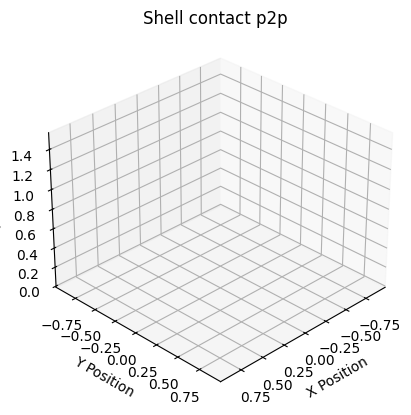

In [14]:
ani = dismech.get_animation(robot, t, qs, options)
ani.save('jellyfish.gif')